## AIM: Perform cluster analysis with extracted SSL features, to see if features form clusters per diagnosis

In [1]:
import numpy as np
import pandas as pd
import sklearn
import pickle
import mne
import os
%matplotlib widget
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer

%matplotlib inline

# prevent extensive logging
mne.set_log_level('WARNING')

In [2]:
# set working directory
os.chdir(r'D:\Documents\Master_Data_Science\Thesis\thesis_code\DataScience_Thesis')
print(os.getcwd())

d:\Documents\Master_Data_Science\Thesis\thesis_code\DataScience_Thesis


## Functions:

In [3]:
def load_file(file):
    with open(file, 'rb') as handle:
        return pickle.load(handle)

In [4]:
def tsne_plot(X, Y, title, perplexity):
    """
    Function to plot 2D & 3D t-SNE plot of the given data.
    param X: feature matrix
    param Y: labels
    param title: title of the plot
    param perplexity: perplexity of the t-SNE
    """
    %matplotlib widget

    # Define TSNE model for 3D plot
    tsne_3d = TSNE(n_components=3, verbose=0, perplexity=perplexity, n_iter=300)
    X_tsne_3d = tsne_3d.fit_transform(X)

    # Define TSNE model for 2D plot
    tsne_2d = TSNE(n_components=2, verbose=0, perplexity=perplexity, n_iter=300)
    X_tsne_2d = tsne_2d.fit_transform(X)

    # Create subplots
    fig = plt.figure(figsize=(15, 7))
    ax_2d = fig.add_subplot(121)
    ax_3d = fig.add_subplot(122, projection='3d')

    # Get indices of each class
    d1 = np.array(Y == 'ADHD')
    d2 = np.array(Y == 'HEALTHY')
    d3 = np.array(Y == 'OCD')
    d4 = np.array(Y == 'MDD')
    d5 = np.array(Y == 'SMC')

    # Plot 3D t-SNE
    ax_3d.scatter(X_tsne_3d[d1, 0], X_tsne_3d[d1, 1], X_tsne_3d[d1, 2], c='blue', s=40, label="ADHD", zorder=5)
    ax_3d.scatter(X_tsne_3d[d2, 0], X_tsne_3d[d2, 1], X_tsne_3d[d2, 2], c='orange', s=40, label="HEALTHY", zorder=4)
    ax_3d.scatter(X_tsne_3d[d3, 0], X_tsne_3d[d3, 1], X_tsne_3d[d3, 2], c='green', s=40, label="OCD", zorder=3)
    ax_3d.scatter(X_tsne_3d[d4, 0], X_tsne_3d[d4, 1], X_tsne_3d[d4, 2], c='#D12B60', s=40, label="MDD", zorder=2)
    ax_3d.scatter(X_tsne_3d[d5, 0], X_tsne_3d[d5, 1], X_tsne_3d[d5, 2], c='purple', s=40, label="SMC", zorder=1)
    ax_3d.legend()
    ax_3d.set_title('3D t-SNE clustering')

    # Plot 2D t-SNE
    ax_2d.scatter(X_tsne_2d[d1, 0], X_tsne_2d[d1, 1], c='blue', s=40, label="ADHD", zorder=5)
    ax_2d.scatter(X_tsne_2d[d2, 0], X_tsne_2d[d2, 1], c='orange', s=40, label="HEALTHY", zorder=4)
    ax_2d.scatter(X_tsne_2d[d3, 0], X_tsne_2d[d3, 1], c='green', s=40, label="OCD", zorder=3)
    ax_2d.scatter(X_tsne_2d[d4, 0], X_tsne_2d[d4, 1], c='#D12B60', s=40, label="MDD", zorder=2)
    ax_2d.scatter(X_tsne_2d[d5, 0], X_tsne_2d[d5, 1], c='purple', s=40, label="SMC", zorder=1)
    ax_2d.legend()
    ax_2d.set_title('2D t-SNE clustering')

    plt.suptitle(f'{title} with perplexity {perplexity}')
    plt.tight_layout()
    plt.show()
    

def pipeline_cluster_analysis(condition, feature_path, perplexities, test_run=False):
    """
    Function to train & tune a model on the given features.
    param condition: condition of the data, e.g. 'tpos1_withinRP', used for saving the model
    param feature_path: path to the feature file
    param perplexity: list with perplexities for iterations of the t-SNE
    param test_run: boolean to run the model on a subset of the original dataframe and lower n_iter
    """
    df_features = load_file(feature_path)
    if test_run:
        # take a subset of 2 participants per class for testing
        # code snippet from GitHub Copilot
        subsampled_df = df_features.groupby('diagnosis', observed=False).apply(
        lambda x: x.groupby('ID', observed=False).head(12).sample(n=5, random_state=42), include_groups=True
        ).reset_index(drop=True)

        # Use the subsampled DataFrame for further processing
        df_features = subsampled_df
        print(f'Shape of subsampled df {df_features.shape}')

        n_iter = 5

    # standardize features  
    numeric_transformer = Pipeline(steps = [
        ('scaler', StandardScaler()), # standardization
        ('impute', SimpleImputer(strategy='mean')) # mean imputation
    ])

    X = df_features.drop(columns=['ID', 'diagnosis'])
    X_scaled = numeric_transformer.fit_transform(X)
    Y = df_features['diagnosis']

    # t-SNE plot
    for perplexity in perplexities:
        tsne_plot(X_scaled, Y, f't-SNE plot of {condition}', perplexity)



# Cluster analysis

## 1. Within RP pretext task

### 1a. Tpos = 1

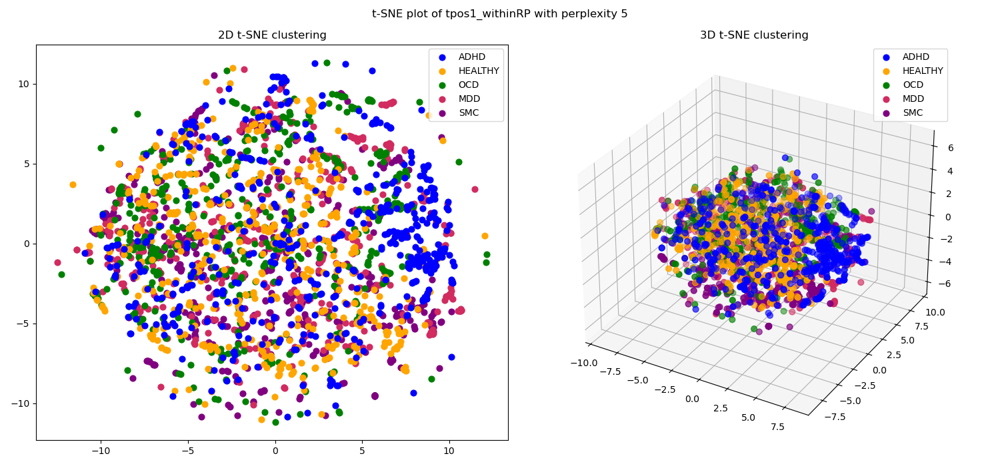

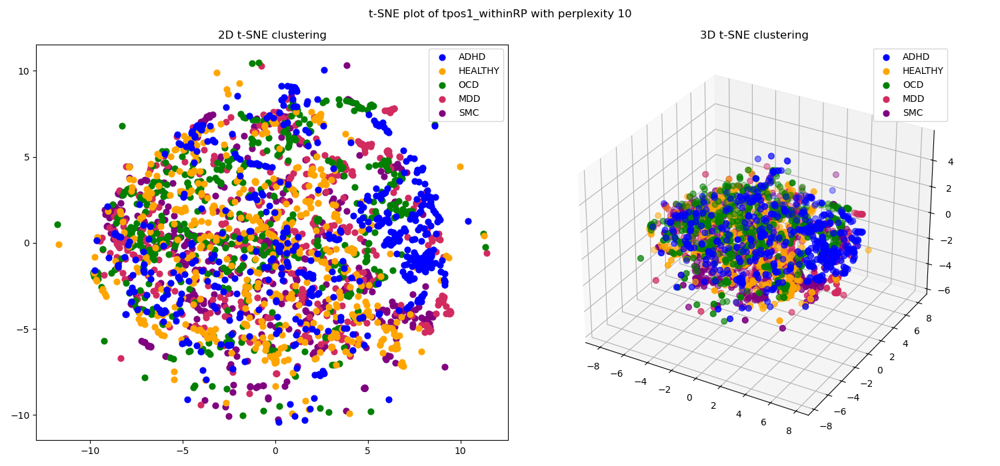

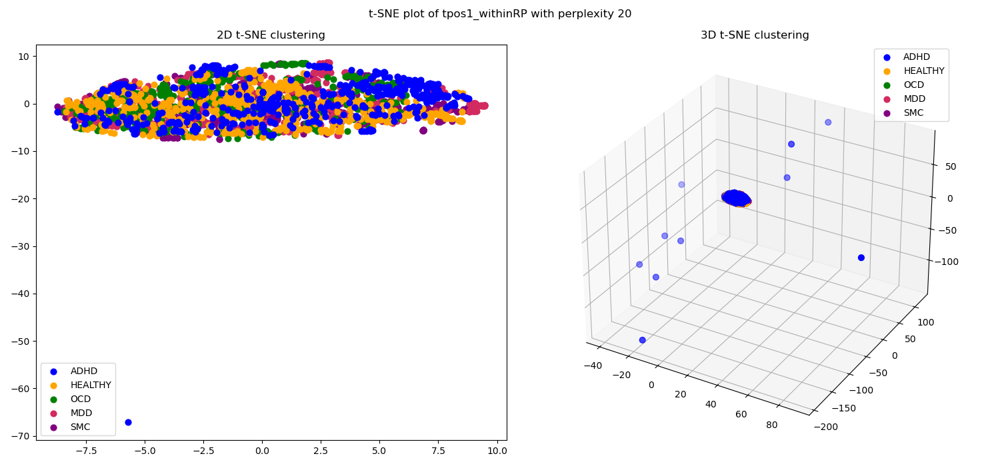

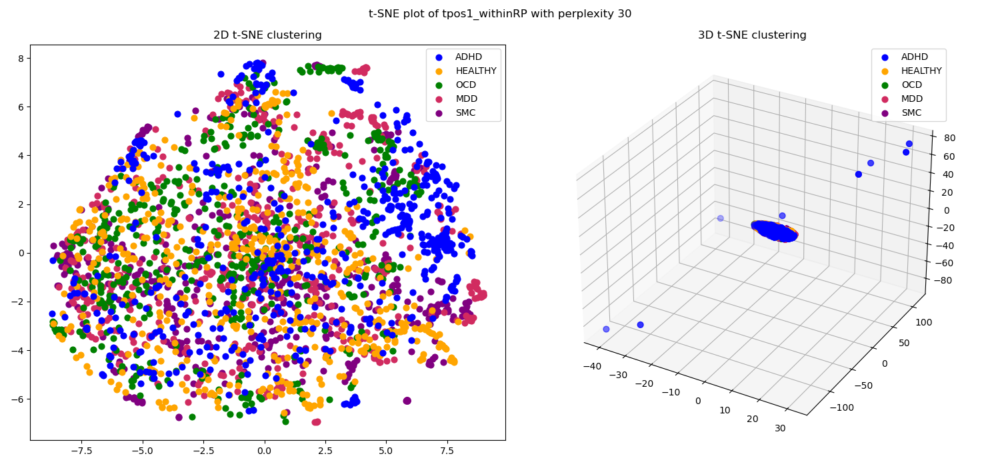

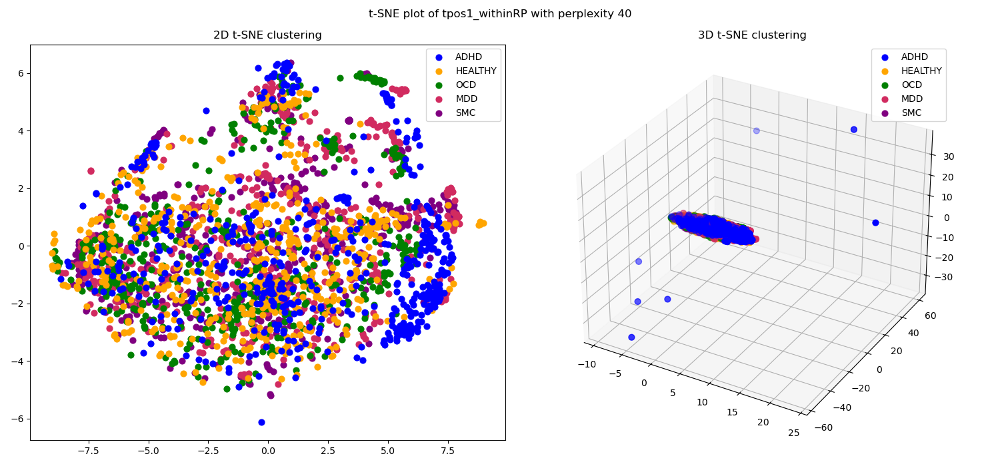

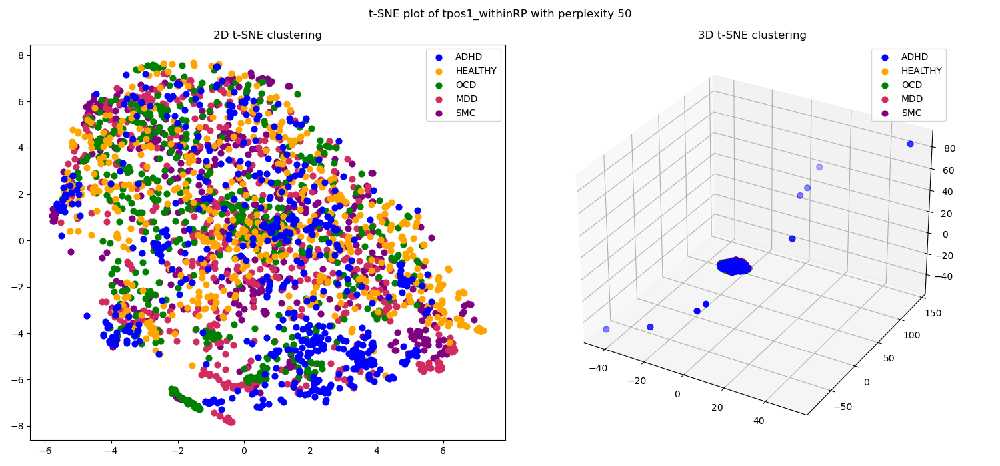

In [5]:
pipeline_cluster_analysis(
    condition='tpos1_withinRP',
    feature_path=r'data/SSL_features/df_fullytrained_withinRP_tpos1_ShallowNet_pretext_model_features.pkl',
    perplexities=[5, 10, 20, 30, 40, 50],
    test_run=False
)

### 1b. Tpos = 2

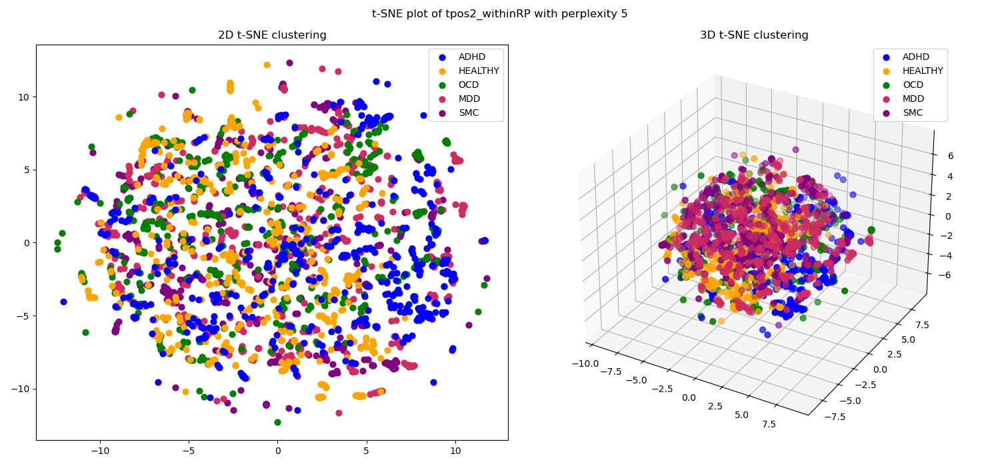

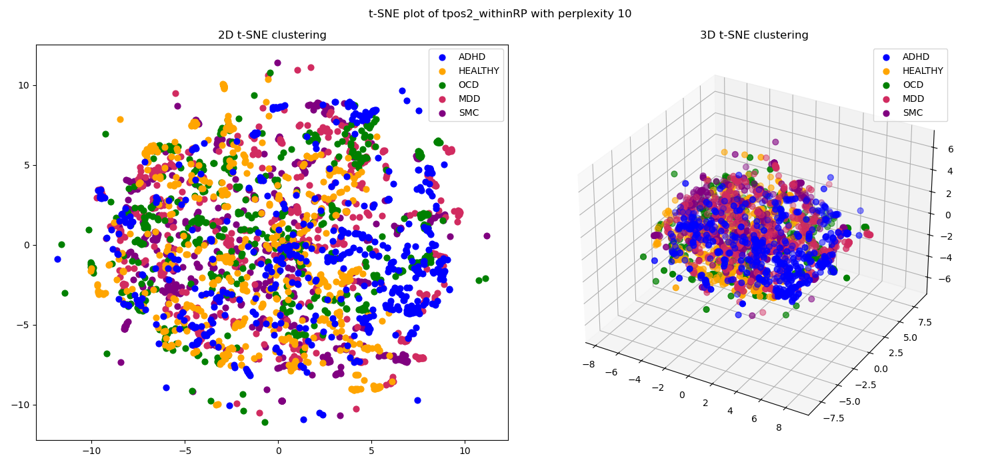

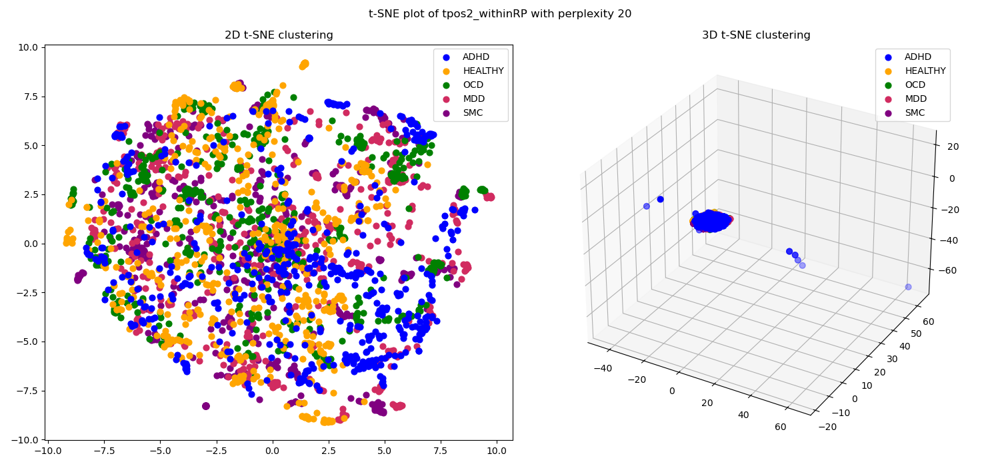

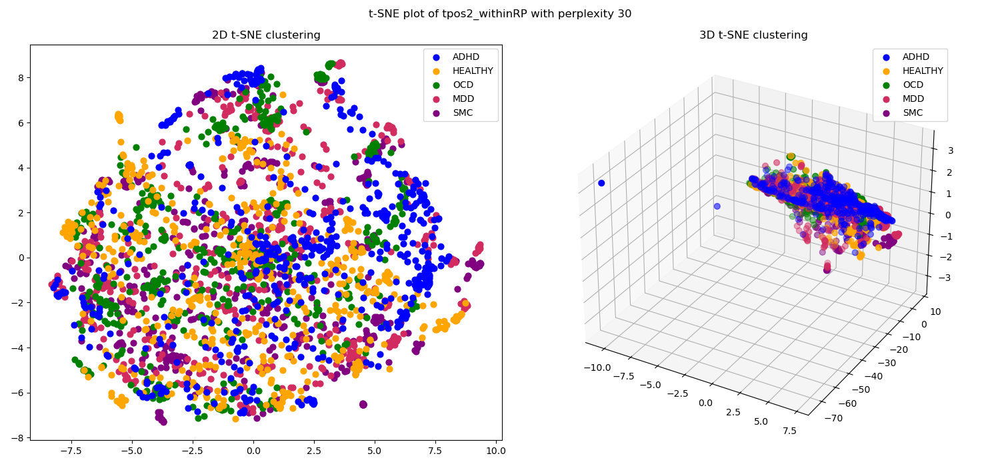

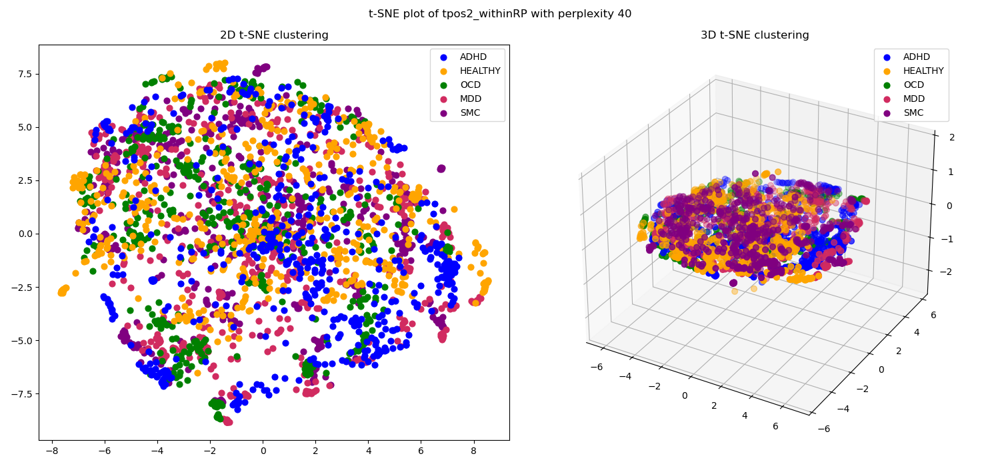

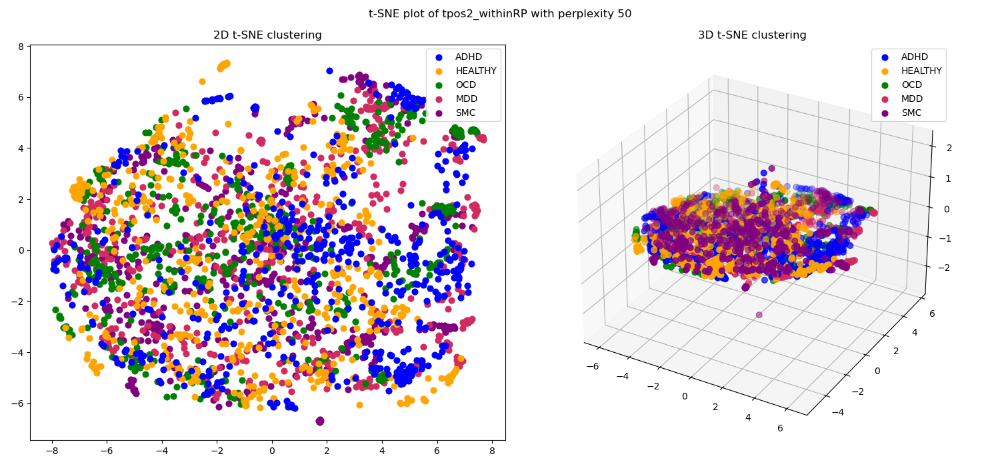

In [6]:
pipeline_cluster_analysis(
    condition='tpos2_withinRP',
    feature_path=r'data/SSL_features/df_fullytrained_withinRP_tpos2_ShallowNet_pretext_model_features.pkl',
    perplexities=[5, 10, 20, 30, 40, 50],
    test_run=False
)

### 1c. Tpos = 4

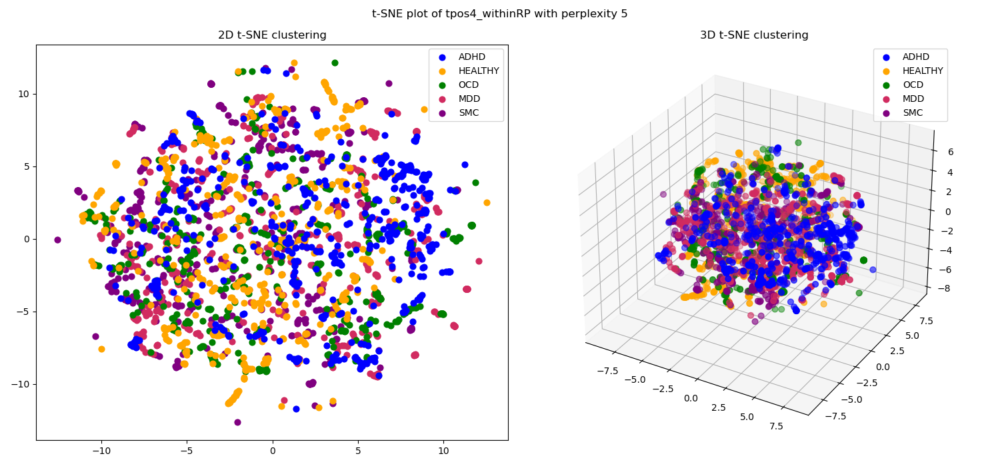

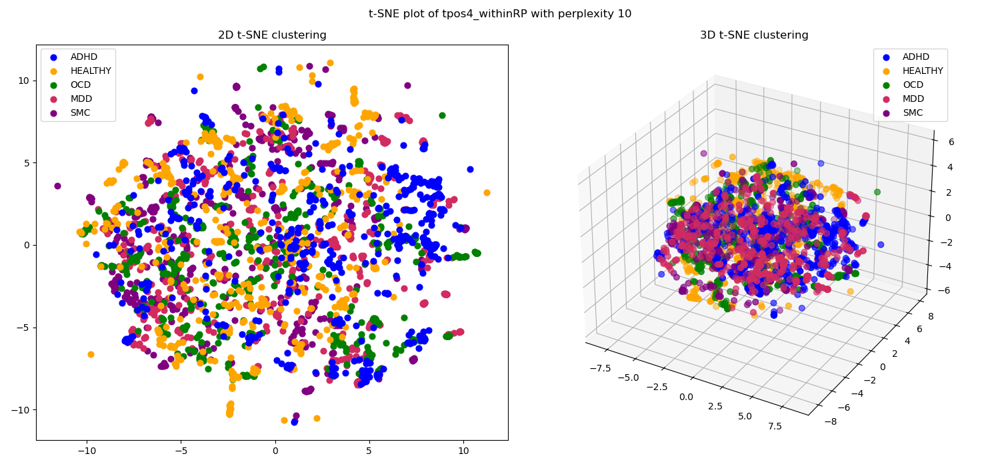

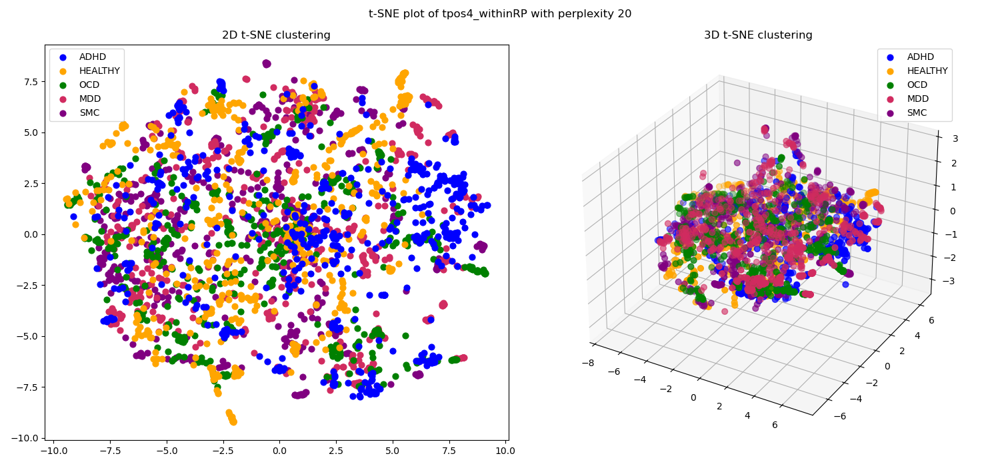

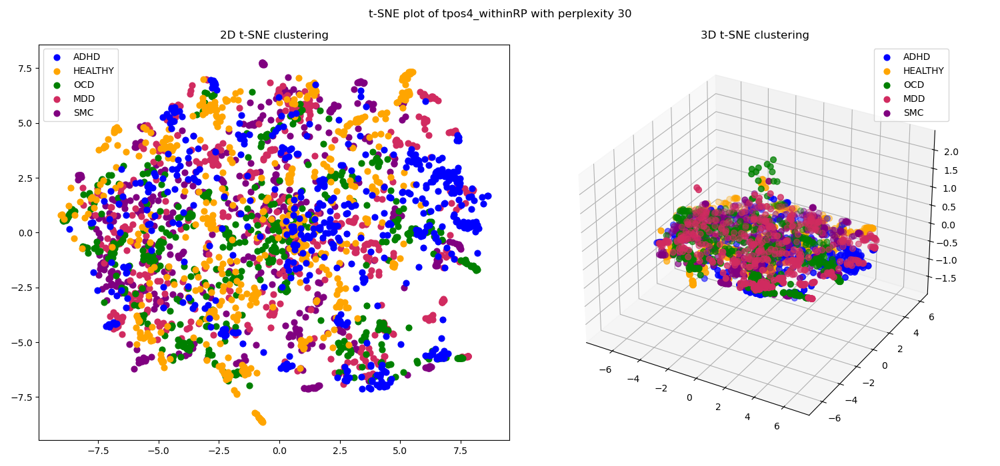

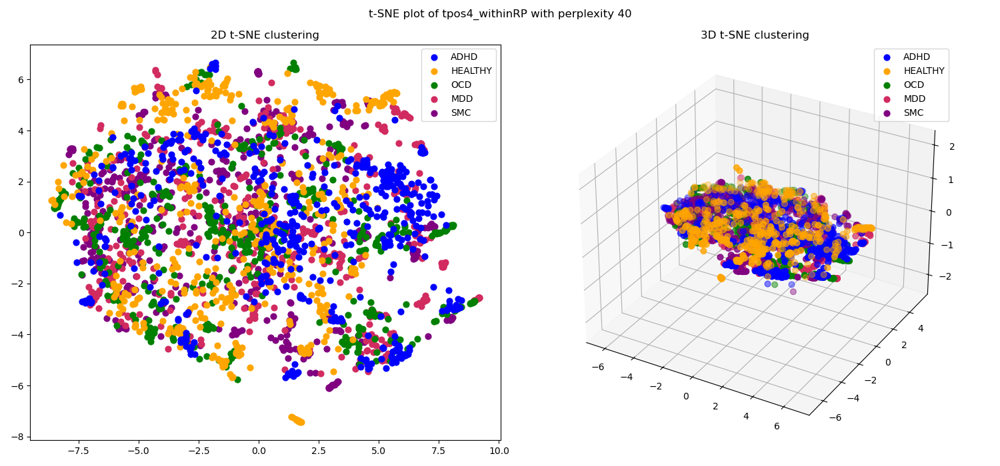

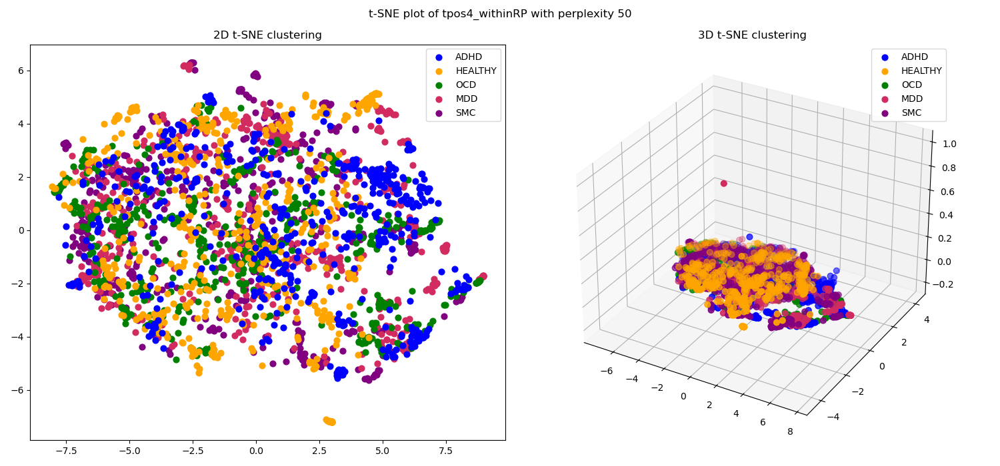

In [7]:
pipeline_cluster_analysis(
    condition='tpos4_withinRP',
    feature_path=r'data/SSL_features/df_fullytrained_withinRP_tpos4_ShallowNet_pretext_model_features.pkl',
    perplexities=[5, 10, 20, 30, 40, 50],
    test_run=False
)

## 2. Across RP pretext task

### 2a. Tpos = 1

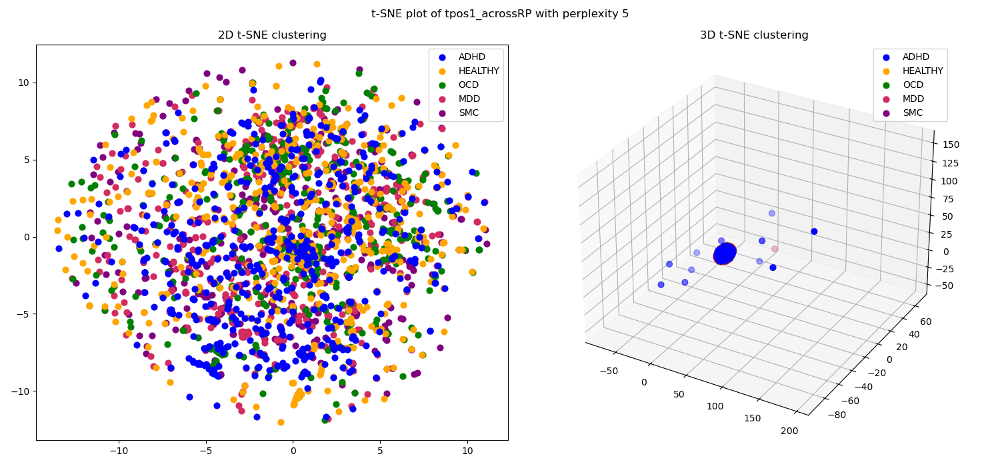

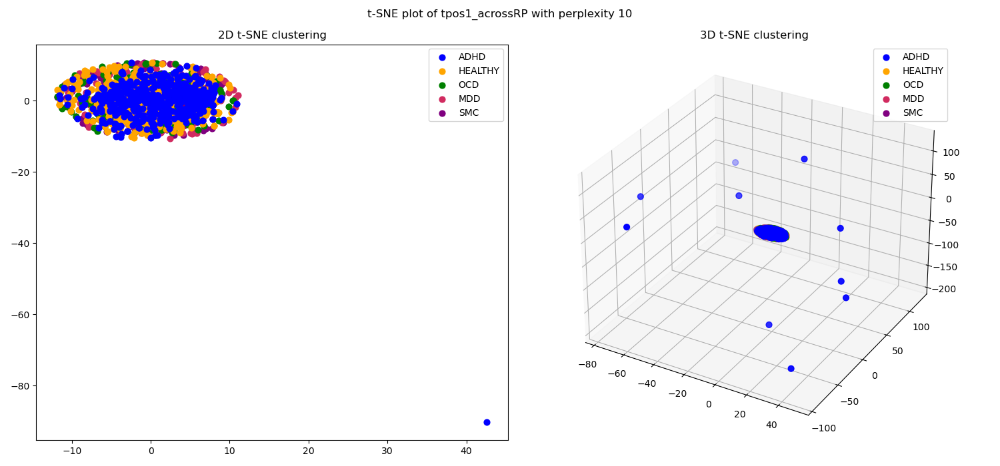

C:\Users\tuur\AppData\Local\Temp\ipykernel_17664\136889791.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(15, 7))


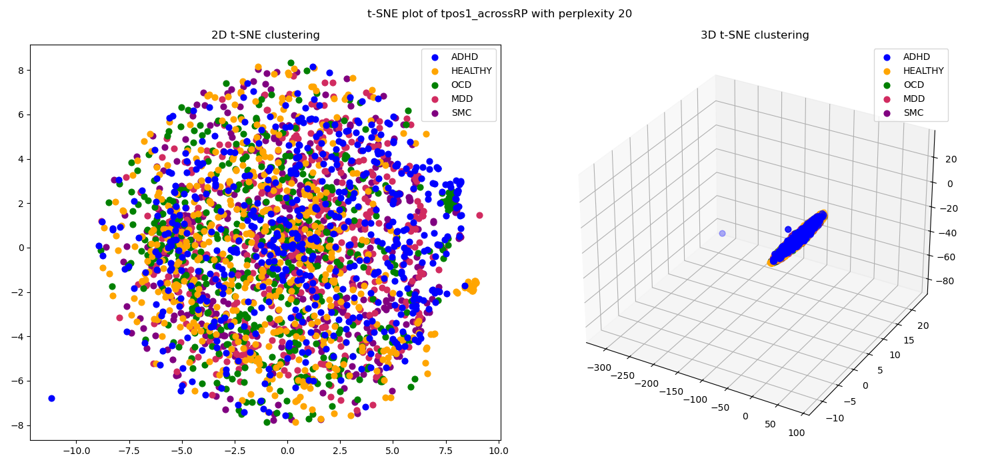

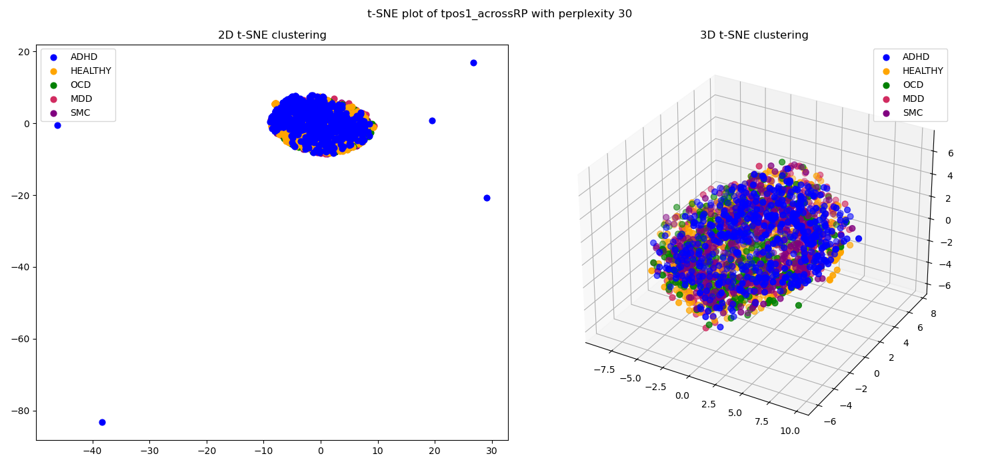

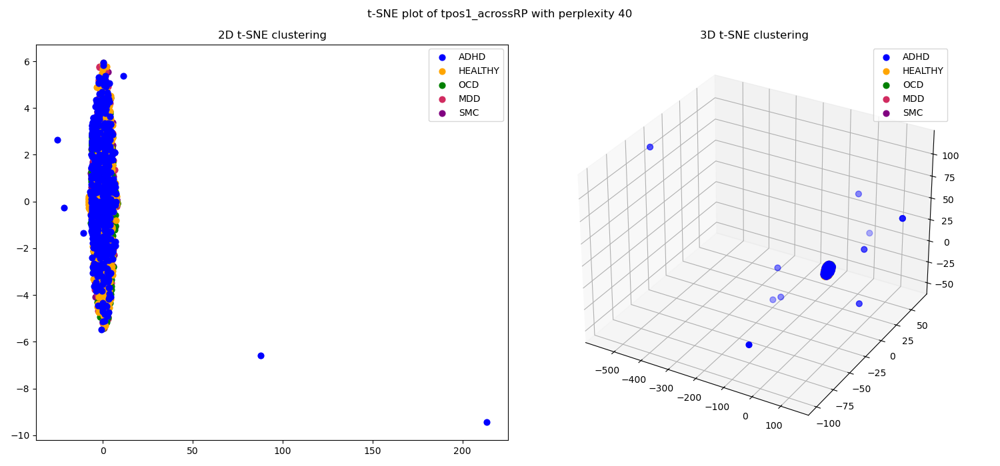

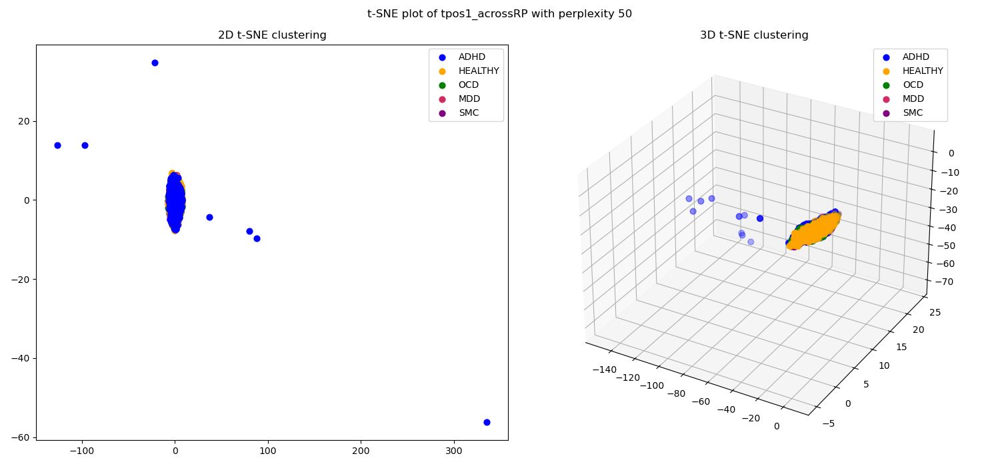

In [8]:
pipeline_cluster_analysis(
    condition='tpos1_acrossRP',
    feature_path=r'data/SSL_features/df_fullytrained_acrossRP_tpos1_ShallowNet_pretext_model_features.pkl',
    perplexities=[5, 10, 20, 30, 40, 50],
    test_run=False
)

### 2b. Tpos = 2

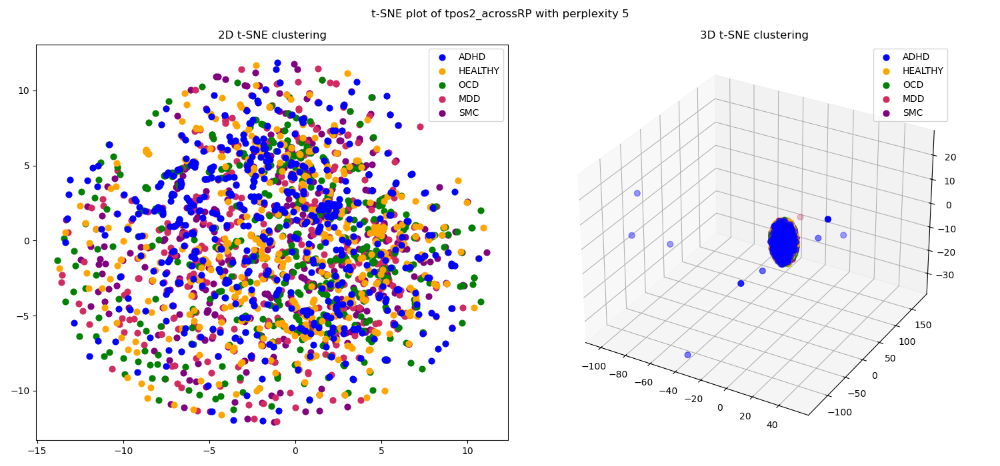

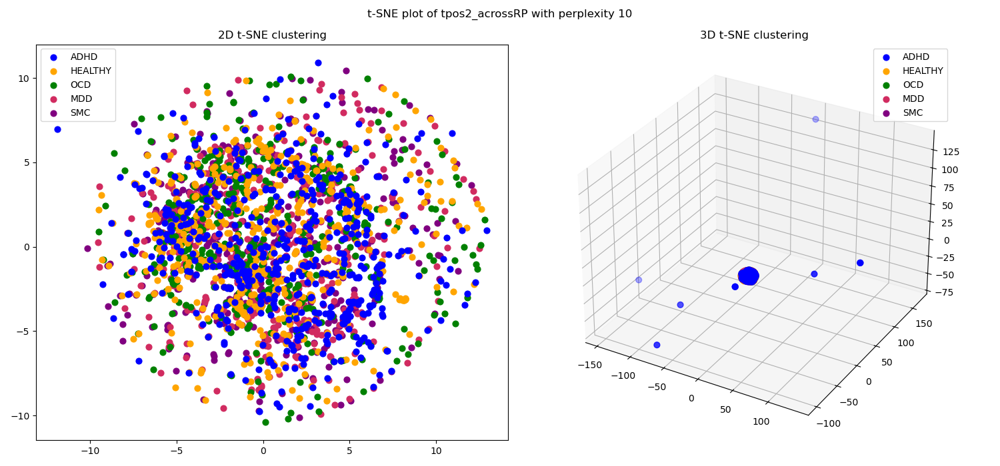

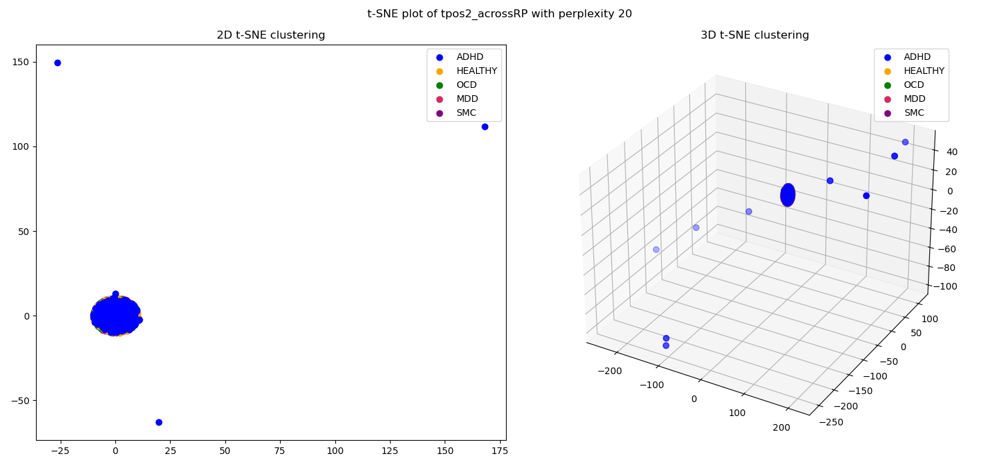

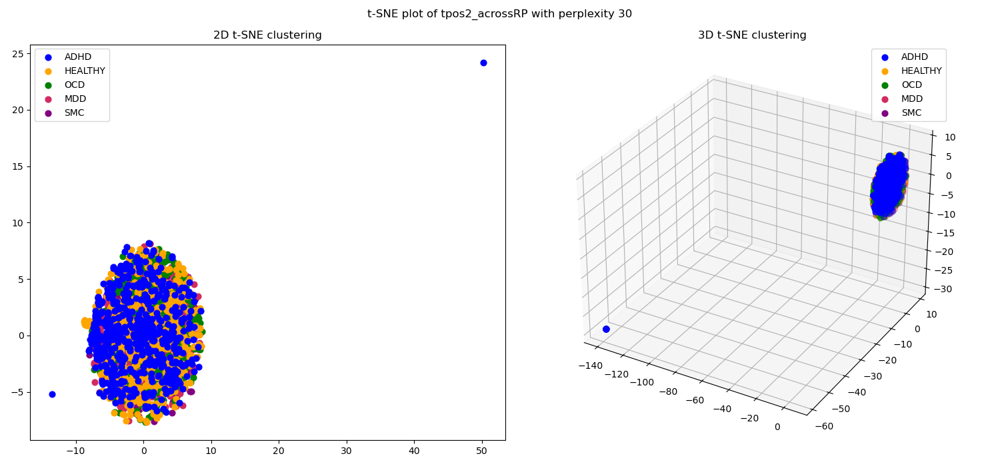

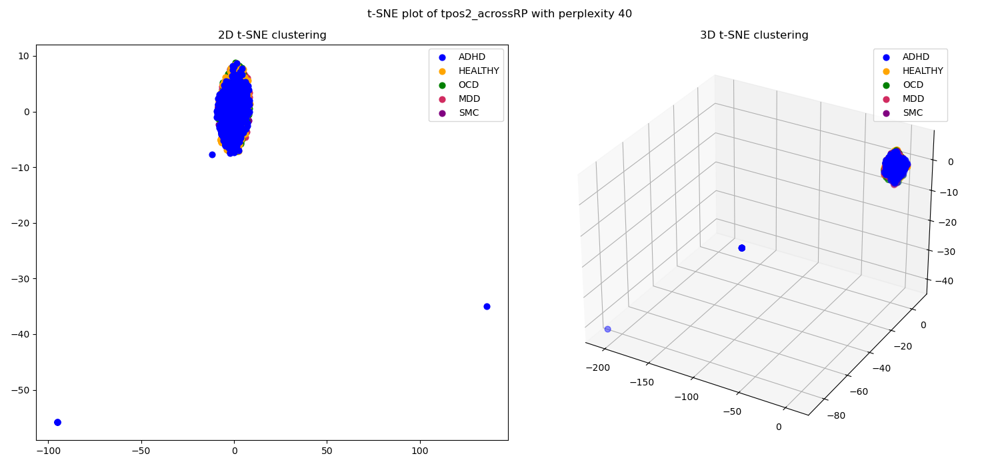

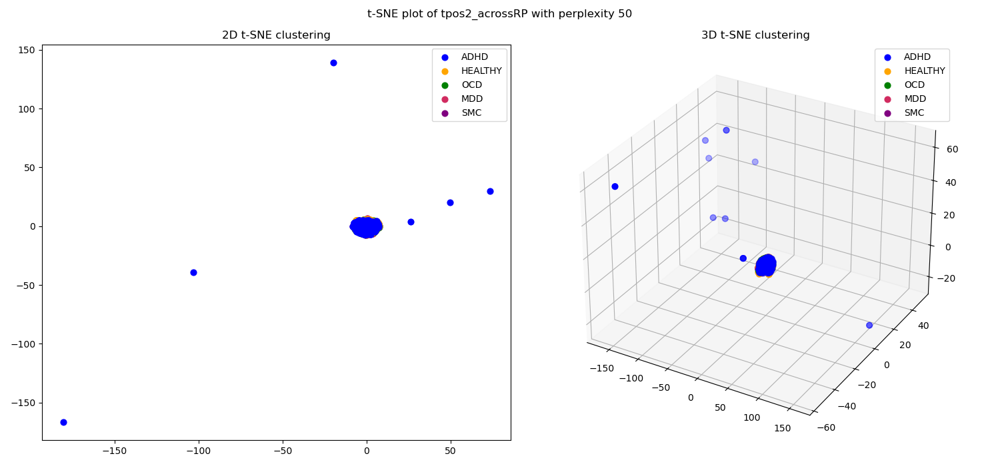

In [9]:
pipeline_cluster_analysis(
    condition='tpos2_acrossRP',
    feature_path=r'data/SSL_features/df_fullytrained_acrossRP_tpos2_ShallowNet_pretext_model_features.pkl',
    perplexities=[5, 10, 20, 30, 40, 50],
    test_run=False
)

### 2c. Tpos = 4

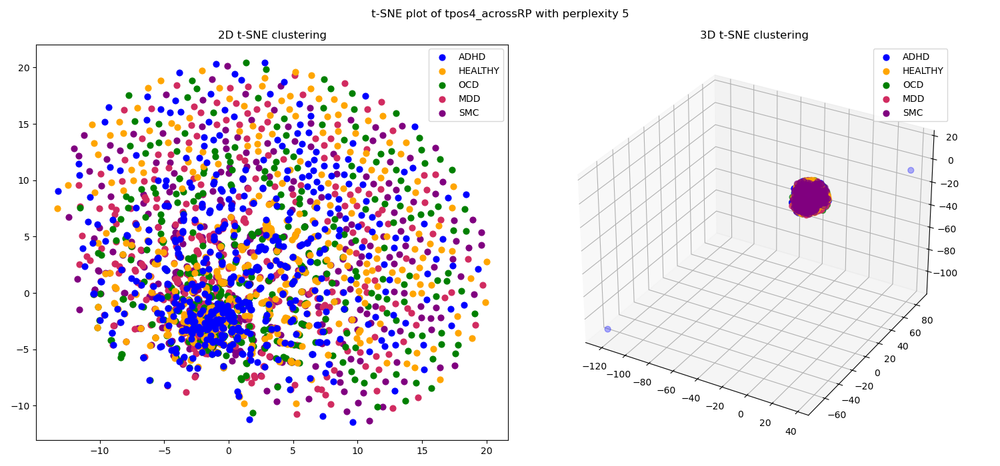

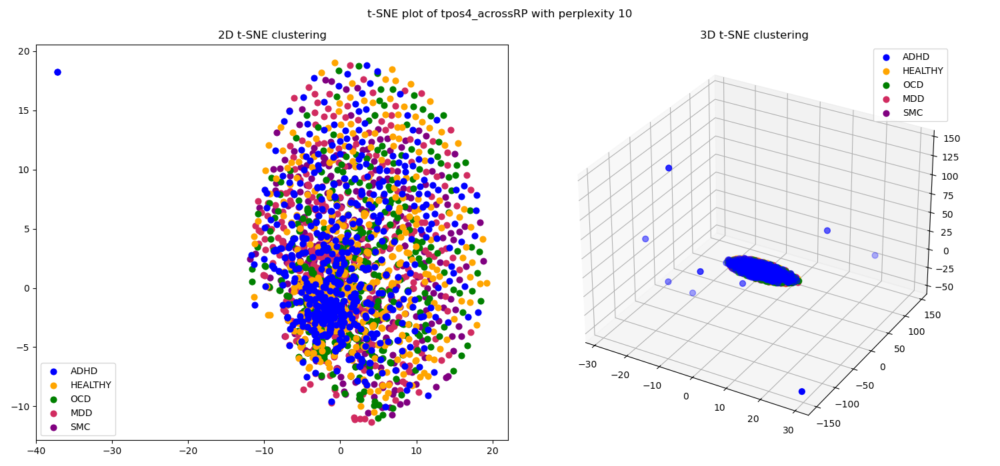

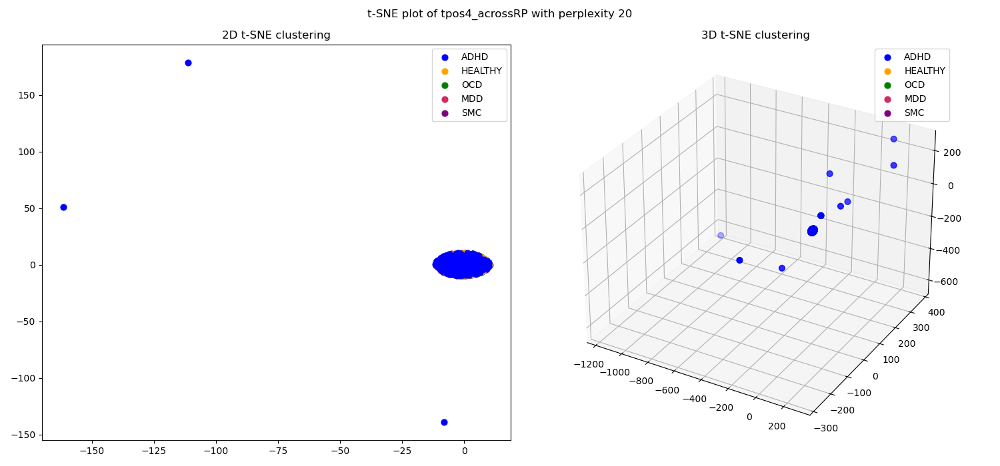

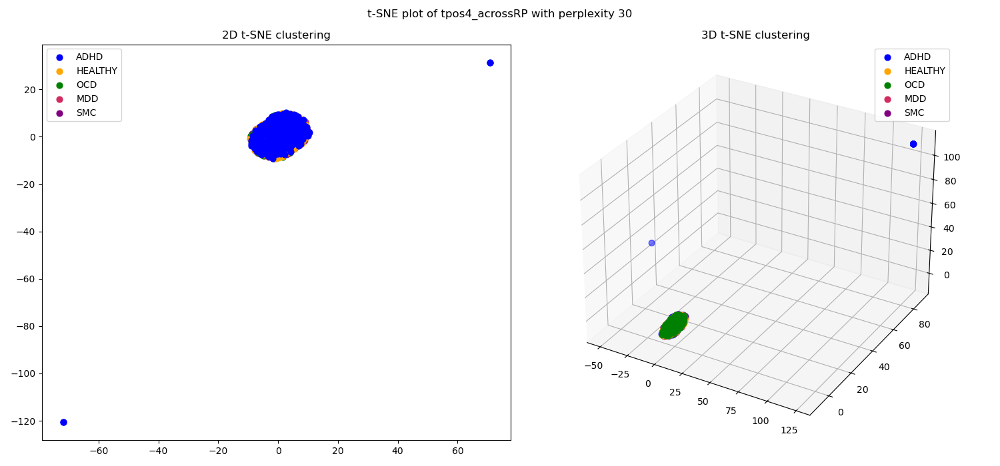

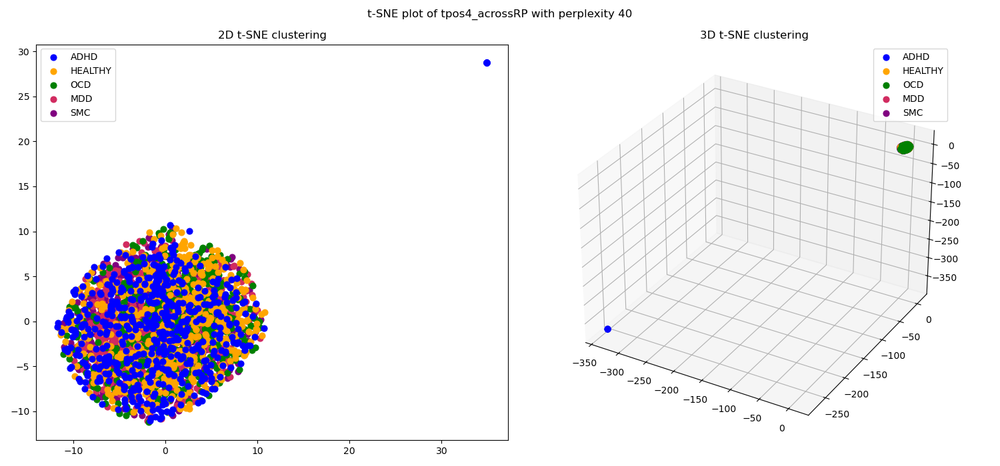

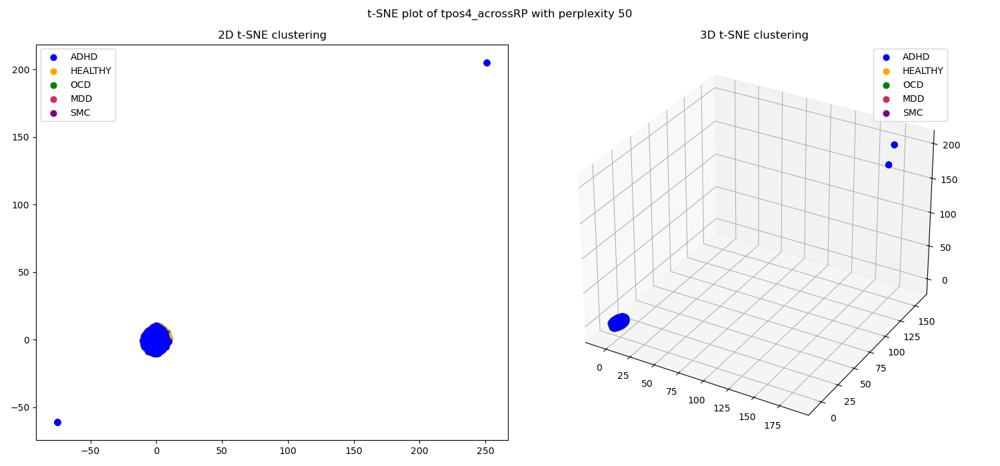

In [10]:
pipeline_cluster_analysis(
    condition='tpos4_acrossRP',
    feature_path=r'data/SSL_features/df_fullytrained_acrossRP_tpos4_ShallowNet_pretext_model_features.pkl',
    perplexities=[5, 10, 20, 30, 40, 50],
    test_run=False
)

## 3. Across subject pretext task

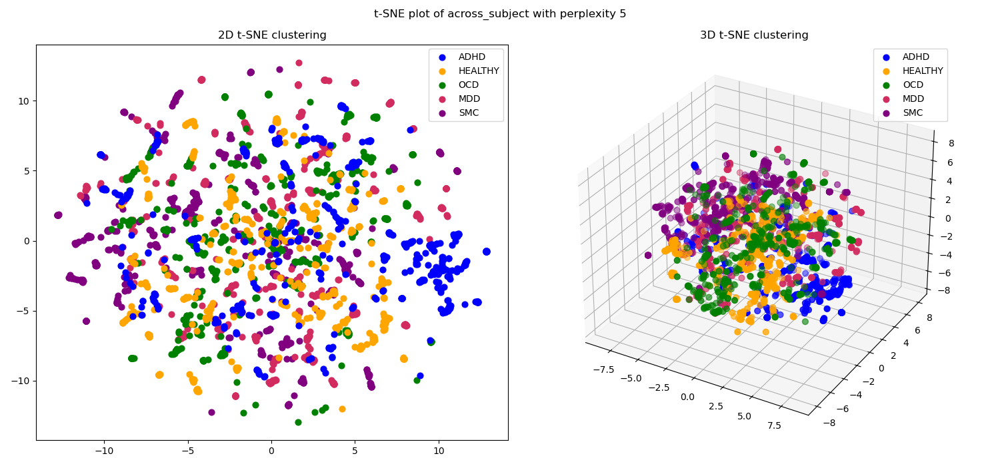

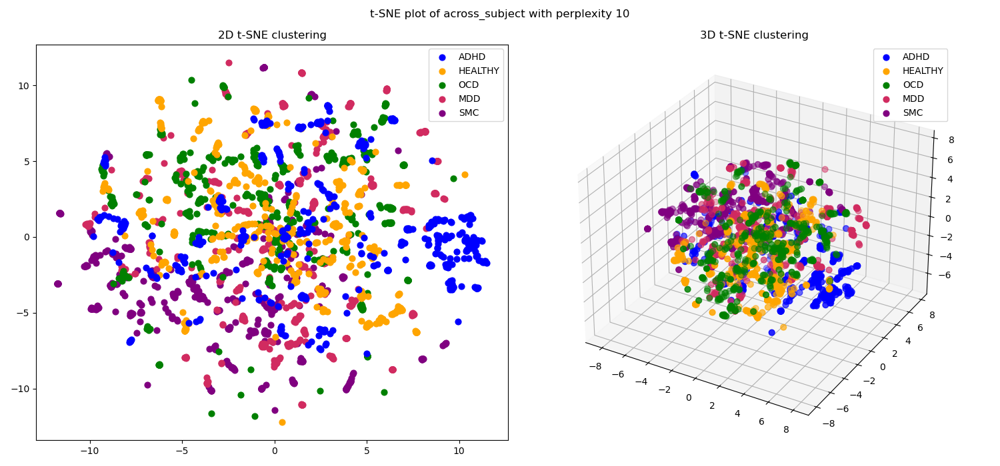

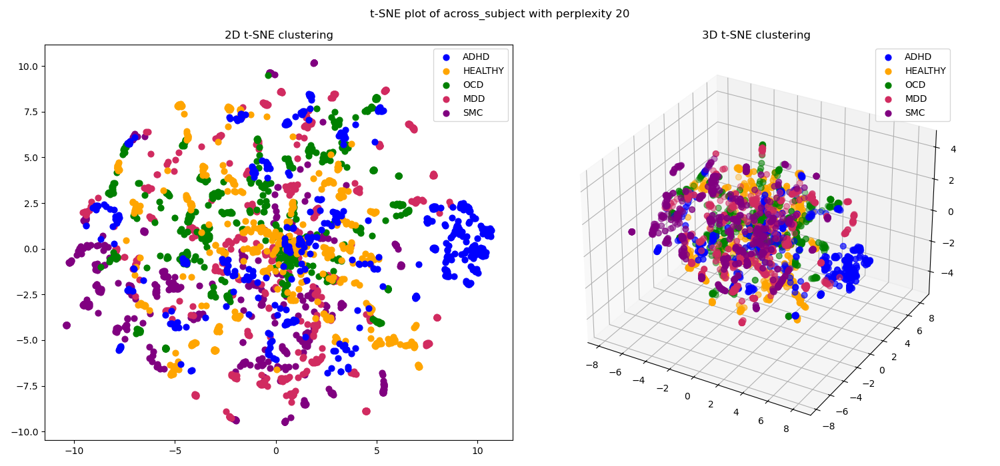

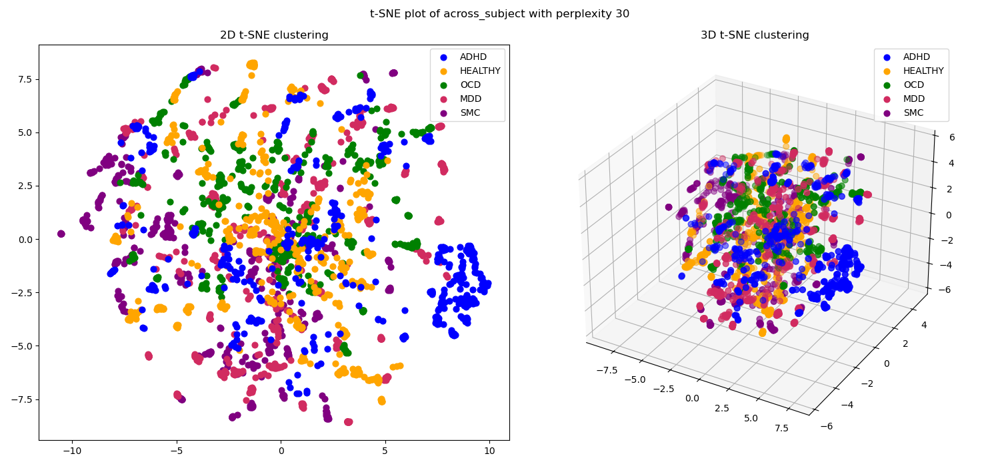

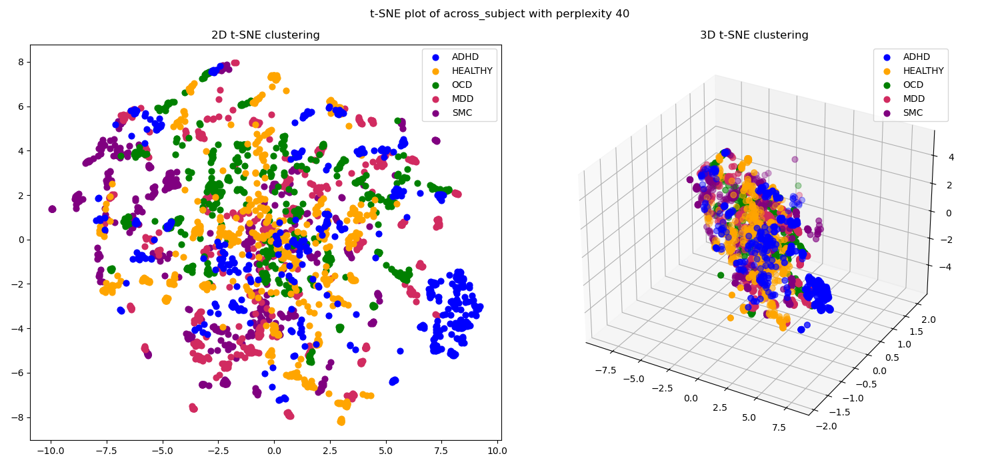

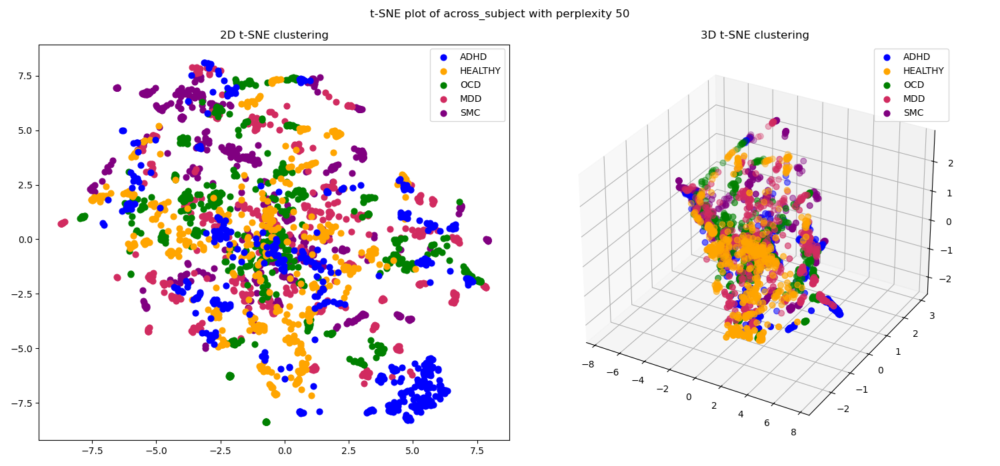

In [11]:
pipeline_cluster_analysis(
    condition='across_subject',
    feature_path=r'data/SSL_features/df_fullytrained_acrosssub_ShallowNet_pretext_model_features.pkl',
    perplexities=[5, 10, 20, 30, 40, 50],
    test_run=False
)

## 4. Contrastive loss pretext task

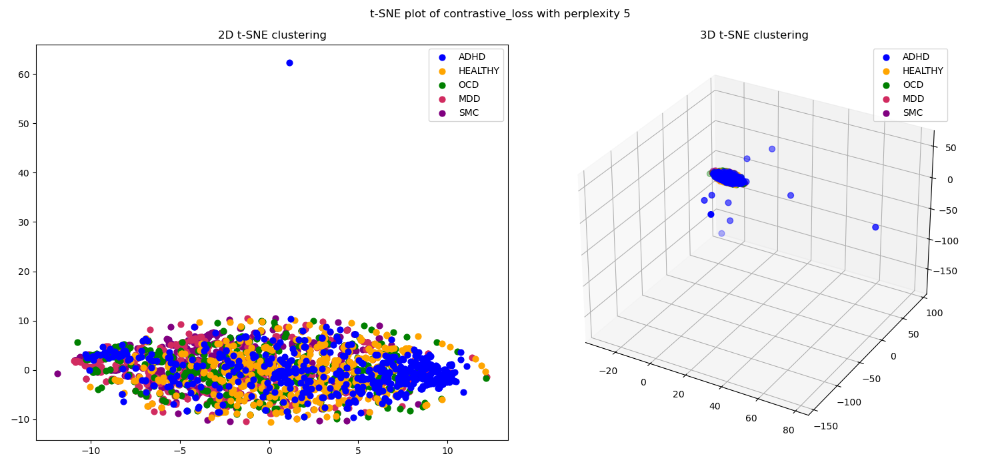

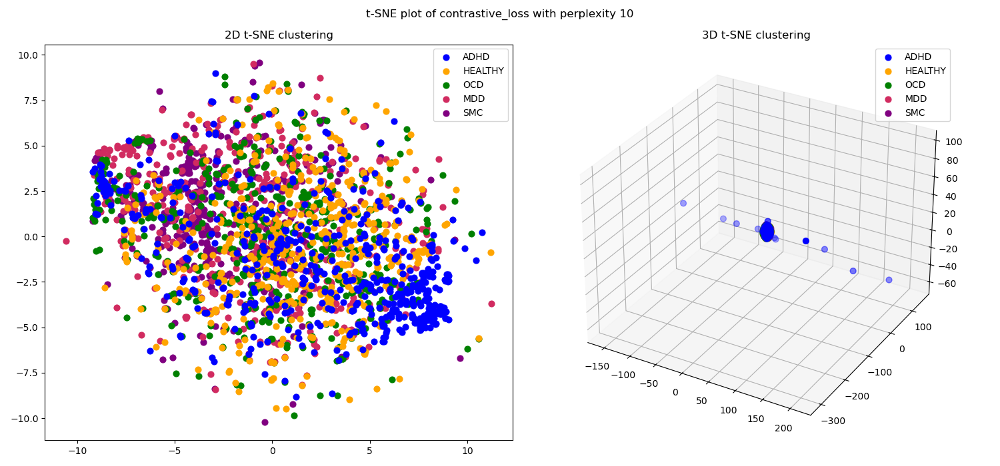

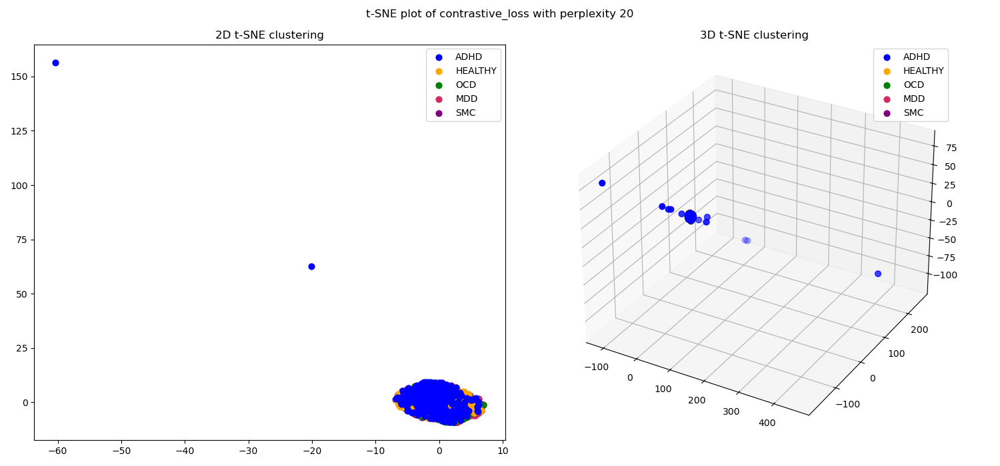

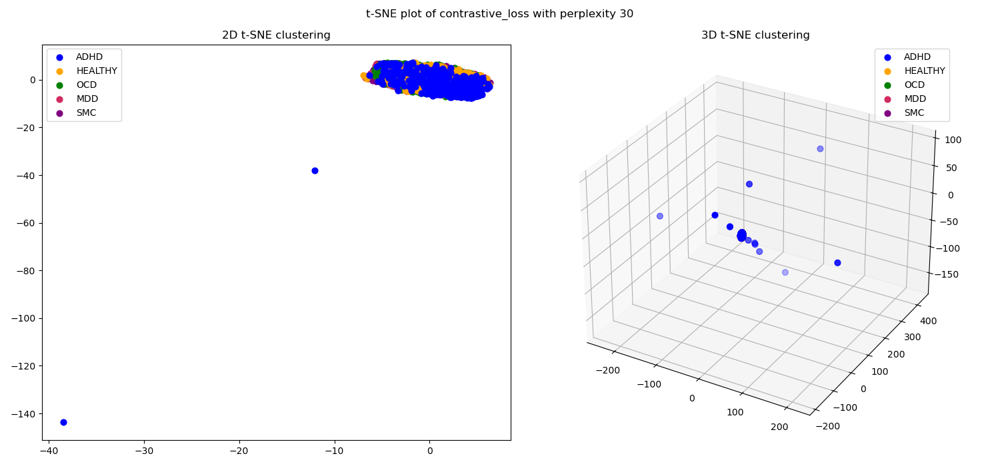

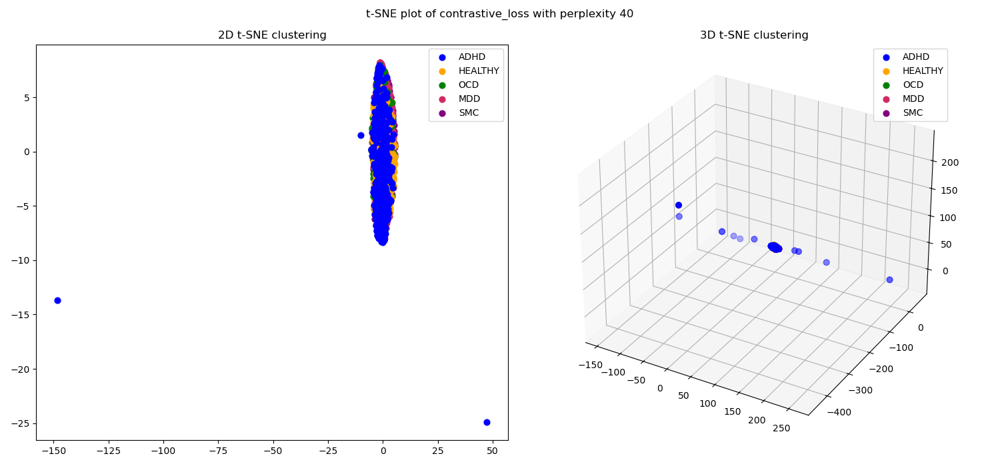

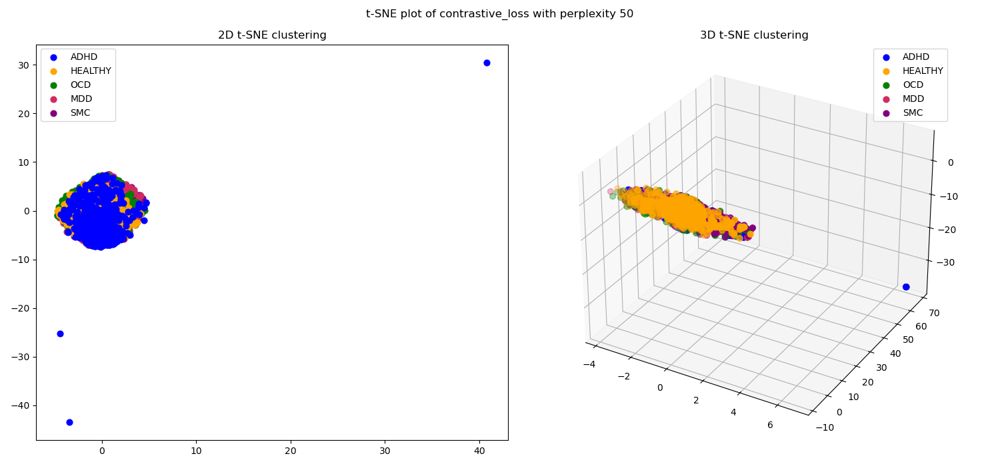

In [12]:
pipeline_cluster_analysis(
    condition='contrastive_loss',
    feature_path=r'data/SSL_features/df_fullytrained_subsaug25f_contrastive_loss_ShallowNet_pretext_model_features.pkl',
    perplexities=[5, 10, 20, 30, 40, 50],
    test_run=False
)